In [18]:
# data wrangling libraries
import pandas as pd
import numpy as np

from urllib.request import urlopen
import json

# plotting
import plotly.graph_objects as go
import plotly.express as px


# helper function library
from src.dw import *
from src.plot_help import *

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


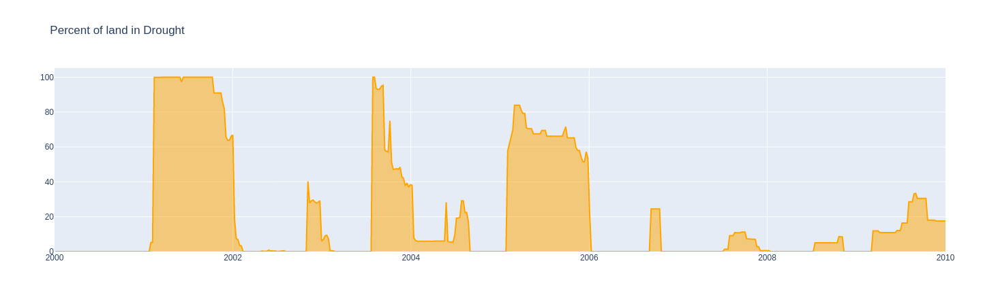

In [305]:
wa_drought = pd.read_csv('data/wa_drought.csv', index_col='Date')

fig = go.Figure()

fig.add_trace(go.Scatter(x=wa_drought.index, y=wa_drought["D1"], 
               name = 'Percent of Land in D1-D4', fill='tonexty', 
                         line=dict(color='orange')
              )

      )

# Add range slider

# fig.update_layout(
# xaxis=dict(
#     rangeselector=dict(
#         buttons=list([
#             dict(count=1,
#                  label="1m",
#                  step="month",
#                  stepmode="backward"),
#             dict(count=6,
#                  label="6m",
#                  step="month",
#                  stepmode="backward"),
#             dict(count=1,
#                  label="YTD",
#                  step="year",
#                  stepmode="todate"),
#             dict(count=1,
#                  label="1y",
#                  step="year",
#                  stepmode="backward"),
#             dict(step="all")
#         ])
#     ),
#     rangeslider=dict(
#         visible=True
#     ),
#     type="date"
# )
# )

fig.update_layout(
    title_text=f'Percent of land in Drought',
    #y_axis = 'Percent of Land'
)

fig.update_layout(xaxis_range=['2000-01-01','2010-01-01'],
                 
                     )
fig.show()


In [308]:
wa_county_tot_dry

,FIPS,County,State,None,D0,D1,D2,D3,D4,ValidStart,ValidEnd,StatisticFormatID
MapDate,,,,,,,,,,,,
2020-03-31,53001,Adams County,WA,16.85,67.76,15.4,0.0,0.0,0.0,2020-03-31,2020-04-06,2
2020-03-24,53001,Adams County,WA,16.85,67.76,15.4,0.0,0.0,0.0,2020-03-24,2020-03-30,2
2020-03-17,53001,Adams County,WA,16.85,67.76,15.4,0.0,0.0,0.0,2020-03-17,2020-03-23,2
2020-03-10,53001,Adams County,WA,16.85,67.76,15.4,0.0,0.0,0.0,2020-03-10,2020-03-16,2
2020-03-03,53001,Adams County,WA,16.85,67.76,15.4,0.0,0.0,0.0,2020-03-03,2020-03-09,2
...,...,...,...,...,...,...,...,...,...,...,...,...
2000-02-01,53077,Yakima County,WA,100.00,0.00,0.0,0.0,0.0,0.0,2000-02-01,2000-02-07,2
2000-01-25,53077,Yakima County,WA,100.00,0.00,0.0,0.0,0.0,0.0,2000-01-25,2000-01-31,2
2000-01-18,53077,Yakima County,WA,100.00,0.00,0.0,0.0,0.0,0.0,2000-01-18,2000-01-24,2


In [317]:
d1

,FIPS,StartDate,EndDate,ConsecutiveWeeks,State,County
0,53001,2001-02-13,2002-01-08,48,WA,Adams County
1,53001,2002-11-05,2002-12-24,8,WA,Adams County
2,53001,2003-07-29,2004-01-06,24,WA,Adams County
3,53001,2005-02-01,2006-01-03,49,WA,Adams County
4,53001,2008-07-15,2008-11-04,17,WA,Adams County
...,...,...,...,...,...,...
193,53077,2001-02-13,2002-01-01,47,WA,Yakima County
194,53077,2002-11-05,2002-12-24,8,WA,Yakima County
195,53077,2003-07-29,2003-12-16,21,WA,Yakima County
196,53077,2005-02-01,2005-12-27,48,WA,Yakima County


In [343]:
d1['ConsecutiveWeeks']

0      48
1       8
2      24
3      49
4      17
       ..
193    47
194     8
195    21
196    48
197    11
Name: ConsecutiveWeeks, Length: 198, dtype: int64

In [362]:
d1 = pd.read_csv('data/wa_4_week_d1.csv')
d2 = pd.read_csv('data/wa_4_week_d2.csv')
d3 = pd.read_csv('data/wa_4_week_d3.csv')

,FIPS,ConsecutiveWeeks,County,Total
0,53001,48,Adams County,108.0
1,53001,8,Adams County,62.0
2,53001,24,Adams County,73.0
3,53001,49,Adams County,66.0
4,53001,17,Adams County,28.0
...,...,...,...,...
193,53077,47,Yakima County,NaN
194,53077,8,Yakima County,NaN
195,53077,21,Yakima County,NaN
196,53077,48,Yakima County,NaN


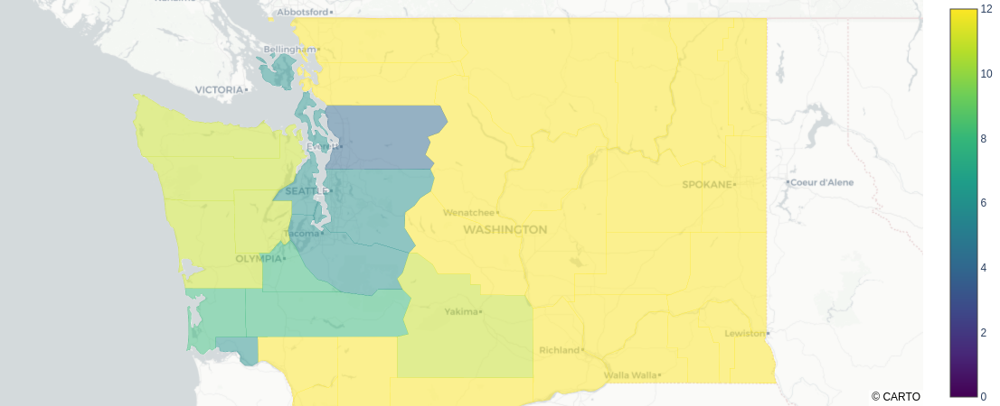

In [365]:
df = d1
# Consectuive Weeks of Moderate Drought (Level D1) in 2000-2010
df['FIPS'] = df['FIPS'].astype(str)

counties = json.loads(open('data/geojson-counties-fips.json').read())

fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=df.FIPS, z=df.ConsecutiveWeeks,
                                    colorscale="Viridis", zmin=0, zmax=12,
                                    marker_opacity=0.5, marker_line_width=0,
                                    text=df.County,
                                    
                                   ))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=6, mapbox_center = {"lat":  47.5, "lon": -120.740135})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})


fig.show()

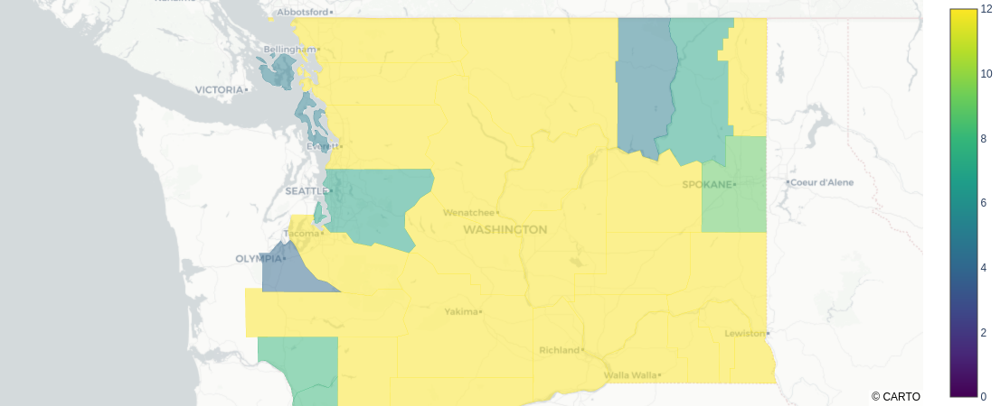

In [364]:
df = d2
# Consectuive Weeks of Severe Drought (Level D2) in 2000-2010
df['FIPS'] = df['FIPS'].astype(str)

counties = json.loads(open('data/geojson-counties-fips.json').read())

fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=df.FIPS, z=df.ConsecutiveWeeks,
                                    colorscale="Viridis", zmin=0, zmax=12,
                                    marker_opacity=0.5, marker_line_width=0,
                                    text=df.County,
                                    
                                   ))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=6, mapbox_center = {"lat":  47.5, "lon": -120.740135})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})


fig.show()

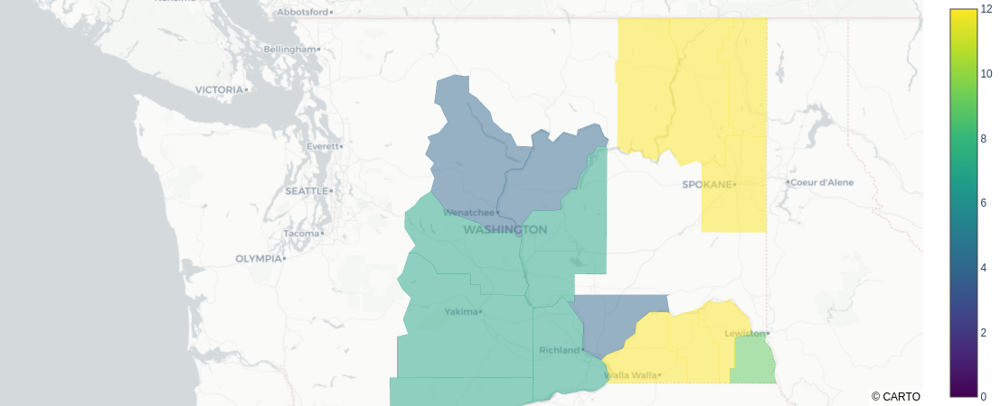

In [366]:
df = d3
# Consectuive Weeks of Extreme Drought (Level D1) in 2000-2010
df['FIPS'] = df['FIPS'].astype(str)

counties = json.loads(open('data/geojson-counties-fips.json').read())

fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=df.FIPS, z=df.ConsecutiveWeeks,
                                    colorscale="Viridis", zmin=0, zmax=12,
                                    marker_opacity=0.5, marker_line_width=0,
                                    text=df.County,
                                    
                                   ))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=6, mapbox_center = {"lat":  47.5, "lon": -120.740135})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})


fig.show()

In [20]:
wheat_yield = pd.read_csv('data/wheat_yield.csv')

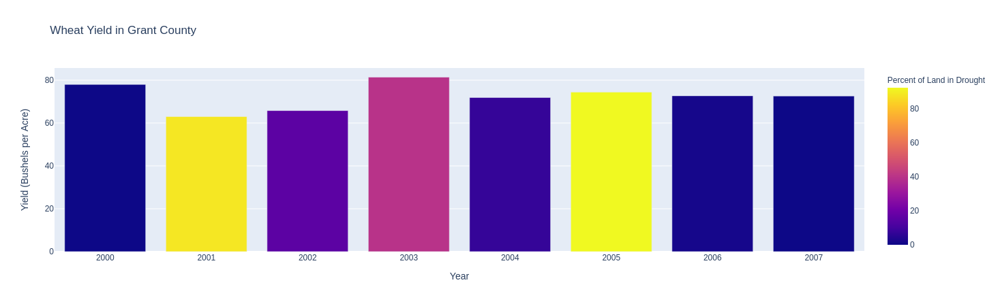

In [283]:
df = grant_drought.copy()
df.reset_index(inplace=True)
df['Year'] = pd.DatetimeIndex(df['MapDate']).year
df = df.groupby(['Year']).mean()

df2 = wheat_yield.loc[wheat_yield['County'] == 'GRANT']
d = df.merge(df2, on='Year')
good_data = d[['Year', 'any_drought', 'Value']]

df = good_data
fig = px.bar(df, x='Year', y='Value',
             labels={'Value':'Yield (Bushels per Acre)', 'any_drought' : 'Percent of Land in Drought'},
             title='Wheat Yield in Grant County', 
             color='any_drought',
             #labels={'pop':'population of Canada'}, height=400
            )
fig.show()

In [31]:
wheat_yield_not_irr = pd.read_csv('data/wheat_yield_not_irr.csv')
wheat_yield_irr = pd.read_csv('data/wheat_yield_irr.csv')


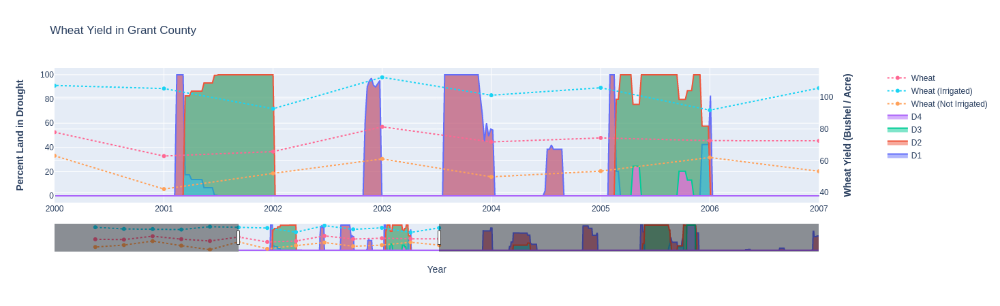

In [32]:
county = 'Grant'
fig = county_crop_helper(wheat_yield_not_irr, grant_drought, "GRANT", "Wheat (Not Irrigated)", "Wheat Yield (Bushel / Acre)")


df2 = wheat_yield_irr.loc[wheat_yield_irr['County'] == 'GRANT']
fig.add_trace(
        go.Scatter(x=df2.Year, y=df2['Value'], name="Wheat (Irrigated)", 
                  line = dict(dash='dot')),
        secondary_y=True,
        )

df3 = wheat_yield.loc[wheat_yield['County'] == 'GRANT']
fig.add_trace(
        go.Scatter(x=df3.Year, y=df3['Value'], name="Wheat", 
                  line = dict(dash='dot')),
        secondary_y=True,
        )


fig.update_layout(xaxis_range=['2000-01-01','2007-01-01'],
                  title_text=f"Wheat Yield in {county} County"
                     )

In [371]:
wheat_yield.loc[wheat_yield['County'] == 'WHITMAN']['Value'].describe()

count    13.000000
mean     71.553846
std       6.215922
min      65.000000
25%      66.700000
50%      70.300000
75%      72.900000
max      85.200000
Name: Value, dtype: float64

In [44]:
wheat_yield.loc[wheat_yield['County'] == 'GRANT'].loc[wheat_yield['Value'] < 72.23]['Year']
#years when wheat yield is below average for Grant County

65     2004
103    2002
124    2001
164    1999
182    1998
218    1996
235    1995
Name: Year, dtype: int64

In [49]:
grant_drought

,FIPS,County,State,None,D0,D1,D2,D3,D4,ValidStart,ValidEnd,StatisticFormatID,any_drought
MapDate,,,,,,,,,,,,,
2020-03-31,53025,Grant County,WA,0.0,43.26,56.59,0.15,0.0,0.0,2020-03-31,2020-04-06,2,56.74
2020-03-24,53025,Grant County,WA,0.0,43.26,56.74,0.00,0.0,0.0,2020-03-24,2020-03-30,2,56.74
2020-03-17,53025,Grant County,WA,0.0,43.26,56.74,0.00,0.0,0.0,2020-03-17,2020-03-23,2,56.74
2020-03-10,53025,Grant County,WA,0.0,43.26,56.74,0.00,0.0,0.0,2020-03-10,2020-03-16,2,56.74
2020-03-03,53025,Grant County,WA,0.0,45.75,54.25,0.00,0.0,0.0,2020-03-03,2020-03-09,2,54.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2000-02-01,53025,Grant County,WA,100.0,0.00,0.00,0.00,0.0,0.0,2000-02-01,2000-02-07,2,0.00
2000-01-25,53025,Grant County,WA,100.0,0.00,0.00,0.00,0.0,0.0,2000-01-25,2000-01-31,2,0.00
2000-01-18,53025,Grant County,WA,100.0,0.00,0.00,0.00,0.0,0.0,2000-01-18,2000-01-24,2,0.00


In [50]:
#wa_drought

df = grant_drought.copy()
df.reset_index(inplace=True)
df['Year'] = pd.DatetimeIndex(df['MapDate']).year
df

,MapDate,FIPS,County,State,None,D0,D1,D2,D3,D4,ValidStart,ValidEnd,StatisticFormatID,any_drought,Year
0,2020-03-31,53025,Grant County,WA,0.0,43.26,56.59,0.15,0.0,0.0,2020-03-31,2020-04-06,2,56.74,2020
1,2020-03-24,53025,Grant County,WA,0.0,43.26,56.74,0.00,0.0,0.0,2020-03-24,2020-03-30,2,56.74,2020
2,2020-03-17,53025,Grant County,WA,0.0,43.26,56.74,0.00,0.0,0.0,2020-03-17,2020-03-23,2,56.74,2020
3,2020-03-10,53025,Grant County,WA,0.0,43.26,56.74,0.00,0.0,0.0,2020-03-10,2020-03-16,2,56.74,2020
4,2020-03-03,53025,Grant County,WA,0.0,45.75,54.25,0.00,0.0,0.0,2020-03-03,2020-03-09,2,54.25,2020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1052,2000-02-01,53025,Grant County,WA,100.0,0.00,0.00,0.00,0.0,0.0,2000-02-01,2000-02-07,2,0.00,2000
1053,2000-01-25,53025,Grant County,WA,100.0,0.00,0.00,0.00,0.0,0.0,2000-01-25,2000-01-31,2,0.00,2000
1054,2000-01-18,53025,Grant County,WA,100.0,0.00,0.00,0.00,0.0,0.0,2000-01-18,2000-01-24,2,0.00,2000
1055,2000-01-11,53025,Grant County,WA,100.0,0.00,0.00,0.00,0.0,0.0,2000-01-11,2000-01-17,2,0.00,2000


In [55]:
df = df.groupby(['Year']).mean()
df.reset_index(inplace=True)
df[['D0', 'D1', 'D2', 'D3', 'D4']].describe()

,D0,D1,D2,D3,D4
count,21.000000,21.000000,21.000000,21.000000,21.0
mean,29.242697,13.502864,13.406606,1.666264,0.0
std,20.688779,15.619764,28.699148,6.733610,0.0
min,1.923077,0.000000,0.000000,0.000000,0.0
25%,11.353846,0.481538,0.000000,0.000000,0.0
50%,30.996538,9.807308,0.000000,0.000000,0.0
75%,45.488654,16.698077,4.240192,0.000000,0.0
max,75.265000,50.095385,85.883846,30.779808,0.0


In [64]:
df[['D0', 'D1', 'D2', 'D3', 'D4', 'Year']].loc[df['Year'] == 2001]

,D0,D1,D2,D3,D4,Year
1,5.769231,10.938654,77.522885,0.0,0.0,2001


In [65]:
df[['D0', 'D1', 'D2', 'D3', 'D4', 'Year']].loc[df['Year'] == 2002]

,D0,D1,D2,D3,D4,Year
2,39.18717,13.443396,1.886792,0.0,0.0,2002


In [66]:
df[['D0', 'D1', 'D2', 'D3', 'D4', 'Year']].loc[df['Year'] == 2004]

,D0,D1,D2,D3,D4,Year
4,75.265,7.108269,0.0,0.0,0.0,2004


In [69]:
wheat_yield['Value'].mean()

58.16341463414635

In [124]:
mean = wheat_yield.loc[wheat_yield['County'] == 'GRANT']['Value'].mean()
mean

72.23076923076923

In [142]:
test = wheat_yield.loc[wheat_yield['County'] == 'GRANT']
#test.all()
test
yield_drought = test.merge(df, on='Year')
yield_drought

,Program,Year,Period,Week Ending,Geo Level,State,State ANSI,Ag District,Ag District Code,County,...,CV (%),FIPS,None,D0,D1,D2,D3,D4,StatisticFormatID,any_drought
0,SURVEY,2007,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,66.474615,33.525385,0.000000,0.000000,0.000000,0.0,2,0.000000
1,SURVEY,2006,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,77.985962,20.421538,1.592500,0.000000,0.000000,0.0,2,1.592500
2,SURVEY,2005,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,0.000000,7.692308,9.807308,78.288654,4.211731,0.0,2,92.307692
3,SURVEY,2004,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,17.626731,75.265000,7.108269,0.000000,0.000000,0.0,2,7.108269
4,SURVEY,2003,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,29.408269,30.996538,39.595192,0.000000,0.000000,0.0,2,39.595192
5,SURVEY,2002,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,45.482642,39.187170,13.443396,1.886792,0.000000,0.0,2,15.330189
6,SURVEY,2001,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,5.769231,5.769231,10.938654,77.522885,0.000000,0.0,2,88.461538
7,SURVEY,2000,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,97.810385,2.189615,0.000000,0.000000,0.000000,0.0,2,0.000000


In [144]:
mean = yield_drought['Value'].mean()
mean

72.475

In [147]:
yield_drought[['D0', 'D1', 'D2', 'D3', 'D4', 'Year', 'Value']].loc[yield_drought['Value'] < mean]

,D0,D1,D2,D3,D4,Year
3,75.265000,7.108269,0.000000,0.0,0.0,2004
5,39.187170,13.443396,1.886792,0.0,0.0,2002
6,5.769231,10.938654,77.522885,0.0,0.0,2001


In [150]:
yield_drought[['D0', 'D1', 'D2', 'D3', 'D4', 'Year', 'Value']].loc[yield_drought['Value'] > mean]

,D0,D1,D2,D3,D4,Year,Value
0,33.525385,0.000000,0.000000,0.000000,0.0,2007,72.6
1,20.421538,1.592500,0.000000,0.000000,0.0,2006,72.7
2,7.692308,9.807308,78.288654,4.211731,0.0,2005,74.4
4,30.996538,39.595192,0.000000,0.000000,0.0,2003,81.4
7,2.189615,0.000000,0.000000,0.000000,0.0,2000,78.0


In [165]:
yield_drought_above_mean = yield_drought.loc[yield_drought['Value'] > mean]

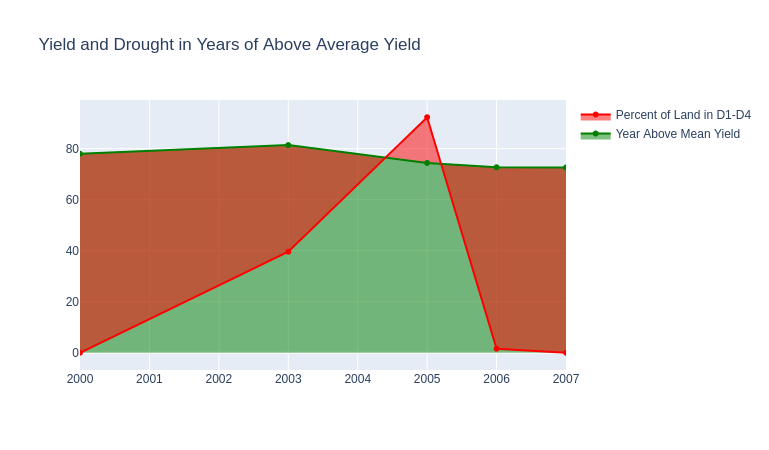

In [179]:
fig = go.Figure()
#fig = county_crop_helper(wheat_yield, grant_drought, "GRANT", "Wheat", "Wheat Yield (Bushel / Acre)")

fig.add_trace(go.Scatter(x=yield_drought_above_mean.Year, y=yield_drought_above_mean["Value"], 
               name = 'Year Above Mean Yield', fill='tonexty', 
                         line=dict(color='green')
              )

      )

fig.add_trace(go.Scatter(x=yield_drought_above_mean.Year, y=yield_drought_above_mean["any_drought"], 
               name = 'Percent of Land in D1-D4', fill='tonexty', 
                         line=dict(color='red')
              )

      )

fig.update_layout(title_text ='Yield and Drought in Years of Above Average Yield')
# fig.add_trace(go.Scatter(x=yield_drought.Year, y=yield_drought["Value"], 
#                name = 'Percent of Land in D1-D4', fill='tonexty', 
#                          #line=dict(color='orange')
#               )

#       )

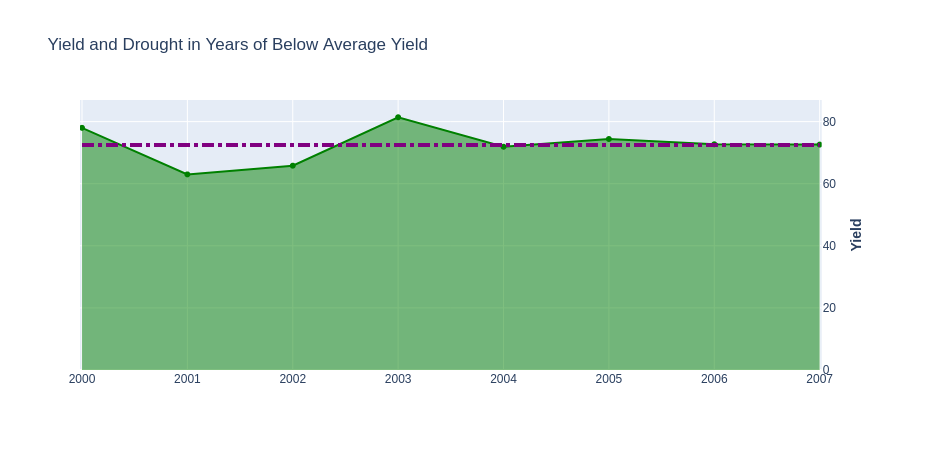

In [259]:
mean = yield_drought['Value'].mean()

#yield_drought_below_mean = yield_drought.loc[yield_drought['Value'] < mean]

fig = make_subplots(specs=[[{"secondary_y": True}]])

#fig = county_crop_helper(wheat_yield, grant_drought, "GRANT", "Wheat", "Wheat Yield (Bushel / Acre)")

#plot drought level
# fig.add_trace(go.Scatter(x=yield_drought['Year'], y=yield_drought["any_drought"], 
#                name = 'Percent of Land in Drought', 
#                          fill='tonexty', 
#                          line=dict(color='red')),
#                          secondary_y=False
              

#       )

#plot yield
fig.add_trace(go.Scatter(x=yield_drought['Year'], y=yield_drought["Value"], 
               name = 'Yield', 
                         fill='tonexty', 
                         line=dict(color='green')),
                         secondary_y=True
              

      )


# # Create scatter trace of text label
# fig.add_trace(go.Scatter(
#     x=[2003],
#     y=[mean - .1],
#     text="(Average Yield)",
#     mode="text",
#     #name='Average Yield'
#     showlegend=False
# ))

fig.add_shape(
    # Line Horizontal
    type="line",
    x0=2000,
    y0=mean,
    x1=2007,
    y1=mean,
    #y1=2,
    line=dict(
        color="Purple",
        width=4,
        dash="dashdot")
    
    )



# Set y-axes titles
fig.update_yaxes(title_text="<b>Percent Land in Drought</b>", secondary_y=False)
fig.update_yaxes(title_text=f"<b>Yield</b>", secondary_y=True)



#ignore none years
# fig.update_xaxes(
#     rangebreaks=[
#         #dict(bounds=["sat", "mon"]), #hide weekends
#         dict(values=["2001.5", "2002.5"])  # hide Christmas and New Year's
#     ]
# )

fig.update_layout(
    title_text ='Yield and Drought in Years of Below Average Yield',
    xaxis_range=['2000-01-01','2007-01-01']
)

#fig.update_xaxes(rangeslider_visible=True)


In [258]:
yield_drought

,Program,Year,Period,Week Ending,Geo Level,State,State ANSI,Ag District,Ag District Code,County,...,CV (%),FIPS,None,D0,D1,D2,D3,D4,StatisticFormatID,any_drought
0,SURVEY,2007,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,66.474615,33.525385,0.000000,0.000000,0.000000,0.0,2,0.000000
1,SURVEY,2006,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,77.985962,20.421538,1.592500,0.000000,0.000000,0.0,2,1.592500
2,SURVEY,2005,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,0.000000,7.692308,9.807308,78.288654,4.211731,0.0,2,92.307692
3,SURVEY,2004,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,17.626731,75.265000,7.108269,0.000000,0.000000,0.0,2,7.108269
4,SURVEY,2003,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,29.408269,30.996538,39.595192,0.000000,0.000000,0.0,2,39.595192
5,SURVEY,2002,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,45.482642,39.187170,13.443396,1.886792,0.000000,0.0,2,15.330189
6,SURVEY,2001,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,5.769231,5.769231,10.938654,77.522885,0.000000,0.0,2,88.461538
7,SURVEY,2000,YEAR,NaN,COUNTY,WASHINGTON,53,EAST CENTRAL,50,GRANT,...,NaN,53025,97.810385,2.189615,0.000000,0.000000,0.000000,0.0,2,0.000000


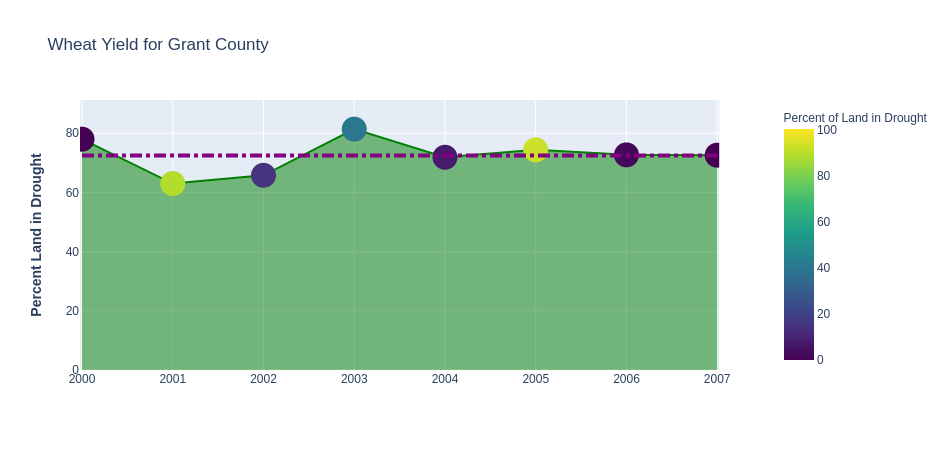

In [282]:
mean = yield_drought['Value'].mean()

yield_drought_below_mean = yield_drought.loc[yield_drought['Value'] < mean]

fig = make_subplots(specs=[[{"secondary_y": True}]])

#fig = county_crop_helper(wheat_yield, grant_drought, "GRANT", "Wheat", "Wheat Yield (Bushel / Acre)")

#plot drought level
# fig.add_trace(go.Scatter(x=yield_drought['Year'], y=yield_drought["any_drought"], 
#                name = 'Percent of Land in Drought', 
#                          fill='tonexty', 
#                          line=dict(color='red')),
#                          secondary_y=False
              

#       )

#plot yield
fig.add_trace(go.Scatter(x=yield_drought['Year'], y=yield_drought["Value"], 
               name = 'Yield', 
                         fill='tonexty', 
                         line=dict(color='green'),
                        marker=dict(
                            size=25,
                            cmax=100,
                            cmin=0,
                            color=yield_drought['any_drought'],
                            colorbar=dict(
                                title="Percent of Land in Drought"),
                            colorscale="Viridis"
                        )))

                         #secondary_y=True
              

      


# # Create scatter trace of text label
# fig.add_trace(go.Scatter(
#     x=[2003],
#     y=[mean - .1],
#     text="(Average Yield)",
#     mode="text",
#     #name='Average Yield'
#     showlegend=False
# ))

fig.add_shape(
    # Line Horizontal
    type="line",
    x0=2000,
    y0=mean,
    x1=2007,
    y1=mean,
    #y1=2,
    line=dict(
        color="Purple",
        width=4,
        dash="dashdot")
    
    )

# df = yield_drought

# fig.add_bar(df, x='Year', y='Value',
#              #labels={'Value':'Yield (Bushels per Acre)', 'any_drought' : 'Percent of Land in Drought'},
#              #title='Wheat Yield in Grant County With Drought Percentage', 
#              color='any_drought',
#              #labels={'pop':'population of Canada'}, height=400
#             )

# Set y-axes titles
fig.update_yaxes(title_text="<b>Percent Land in Drought</b>", secondary_y=False)
fig.update_yaxes(title_text=f"<b>Yield</b>", secondary_y=True)



#ignore none years
# fig.update_xaxes(
#     rangebreaks=[
#         #dict(bounds=["sat", "mon"]), #hide weekends
#         dict(values=["2001.5", "2002.5"])  # hide Christmas and New Year's
#     ]
# )

fig.update_layout(
    title_text ='Wheat Yield for Grant County',
    xaxis_range=['2000-01-01','2007-01-01']
)

